In [130]:
cd cmput_651_final/

[Errno 2] No such file or directory: 'cmput_651_final/'
/home/zeyi/work_station/gpu/cmput_651_final


In [157]:
%run init.ipynb

selected_worlds = get_selected()
world = selected_worlds['den020d.map']

roads = list(filter(lambda t: world.get(t) == World.ROAD, world))
idx_to_pos = dict(enumerate(roads))
vocab_size = len(idx_to_pos)
pos_to_idx = {v: k for k, v in idx_to_pos.items()}
print('vocab_size:', vocab_size)

maps/selected
maps/selected/selected-map/lak110d.map
maps/selected/selected-map/den020d.map
maps/selected/selected-map/den005d.map
maps/selected/selected-map/ost102d.map
maps/selected/selected-map/den001d.map

vocab_size: 3102


In [158]:
model = torch.load('random_paths_model.pt')
model.to('cpu')

Model(
  (embed): Embedding(3102, 16)
  (fc1): Linear(in_features=32, out_features=256, bias=True)
  (do1): Dropout(p=0.5, inplace=False)
  (fc2): Linear(in_features=256, out_features=256, bias=True)
  (do2): Dropout(p=0.5, inplace=False)
  (fc3): Linear(in_features=256, out_features=3102, bias=True)
)

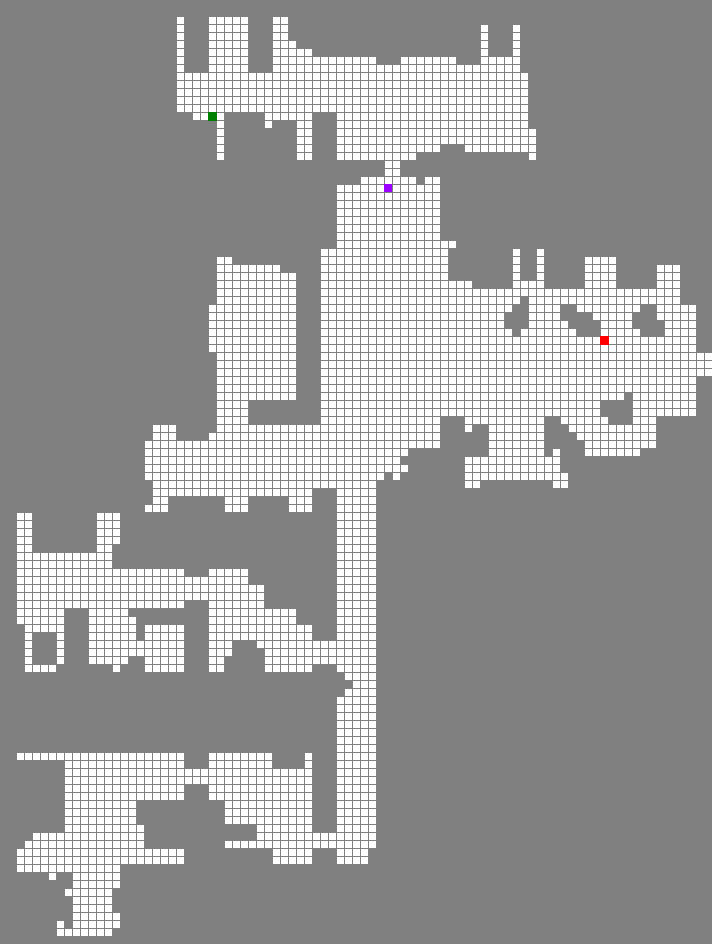

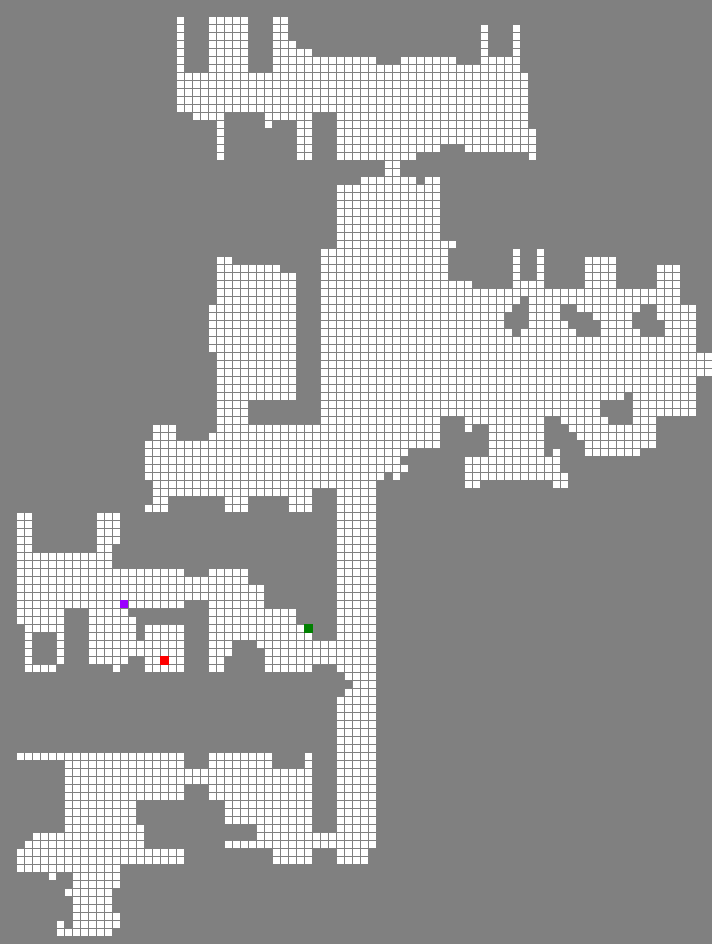

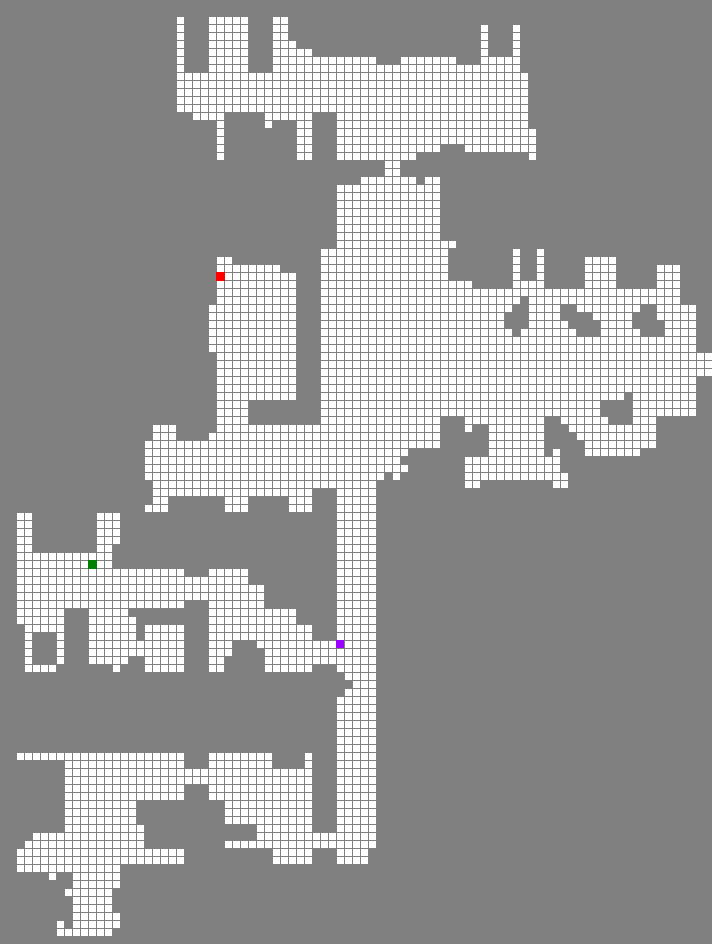

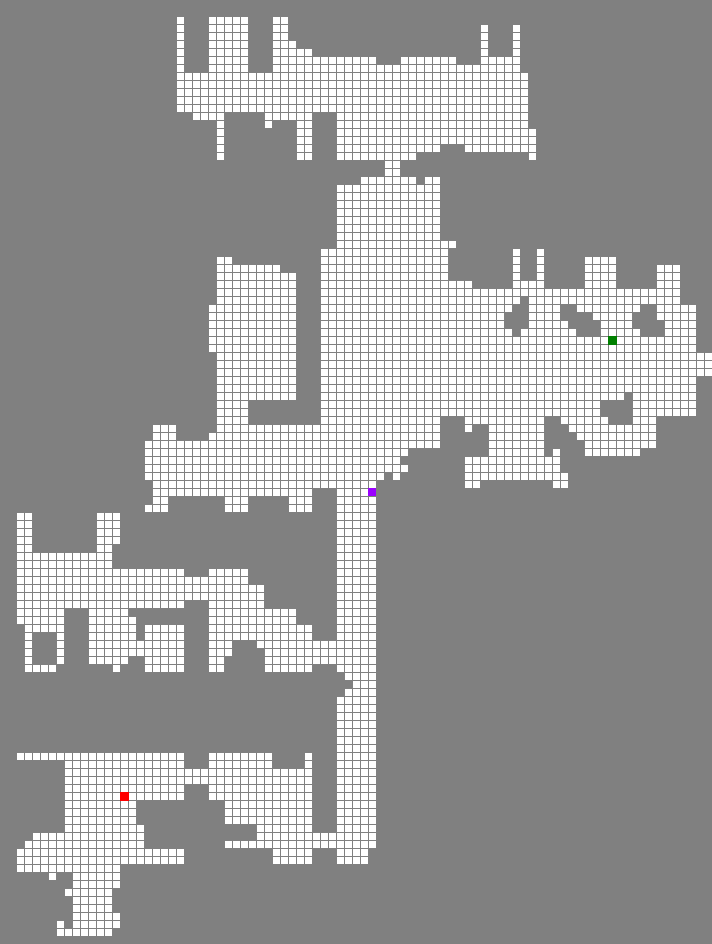

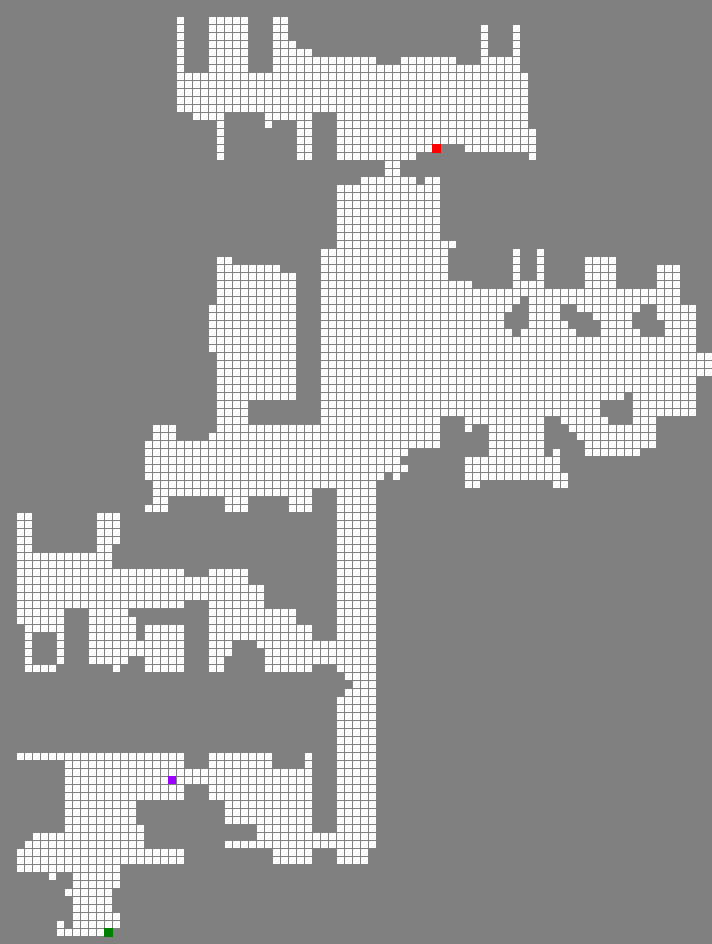

...

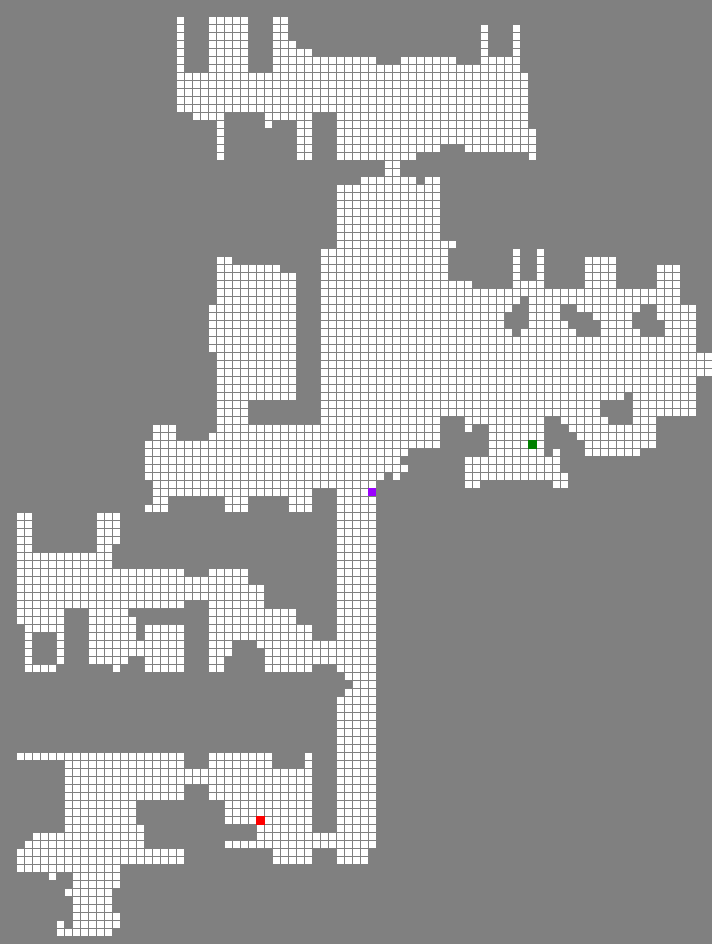

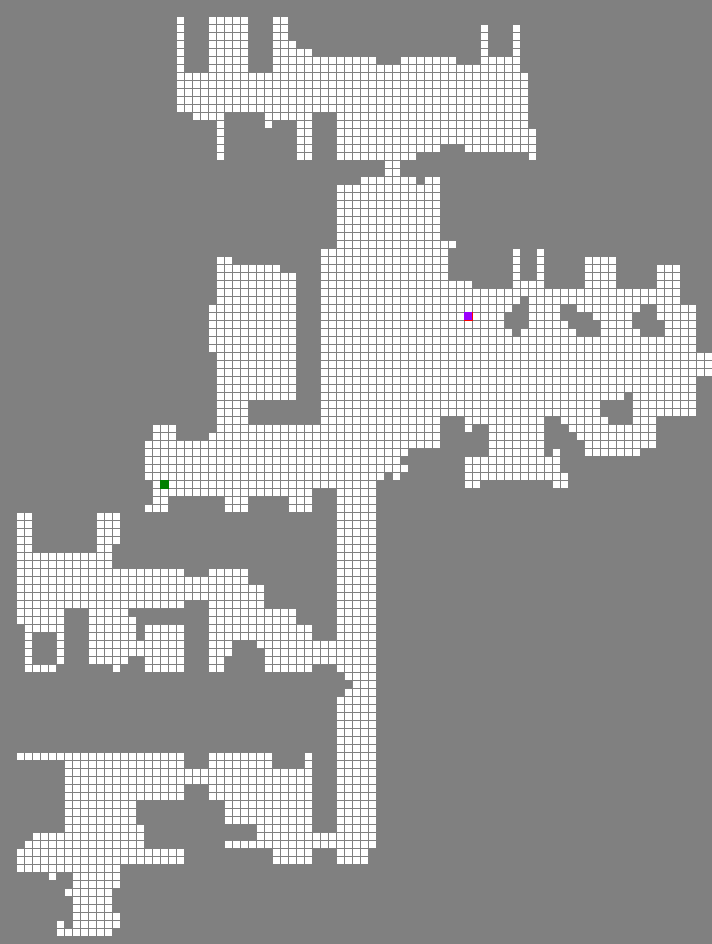

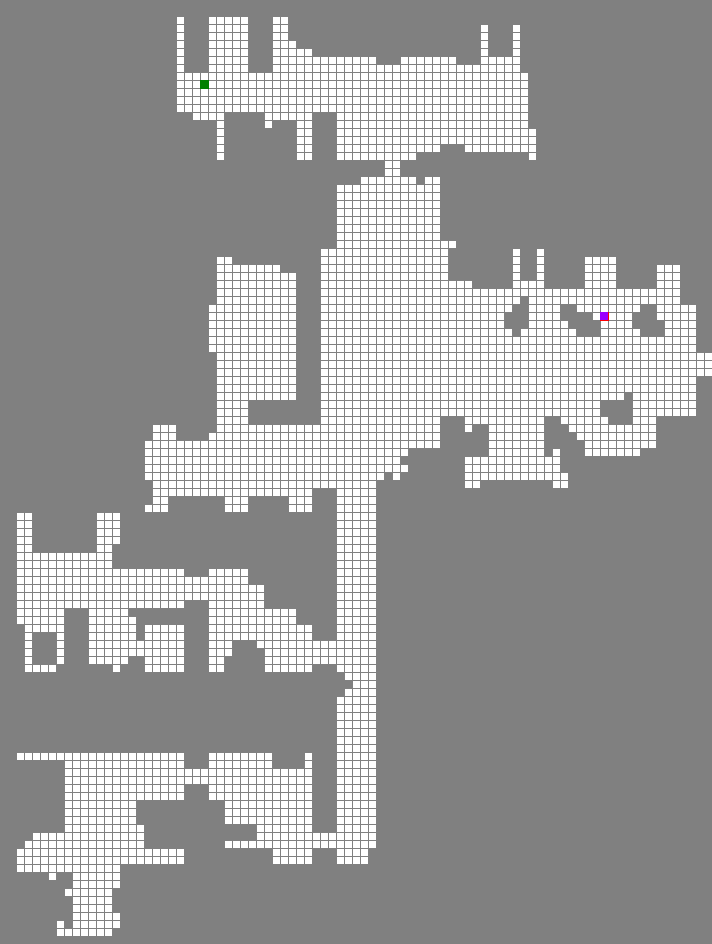

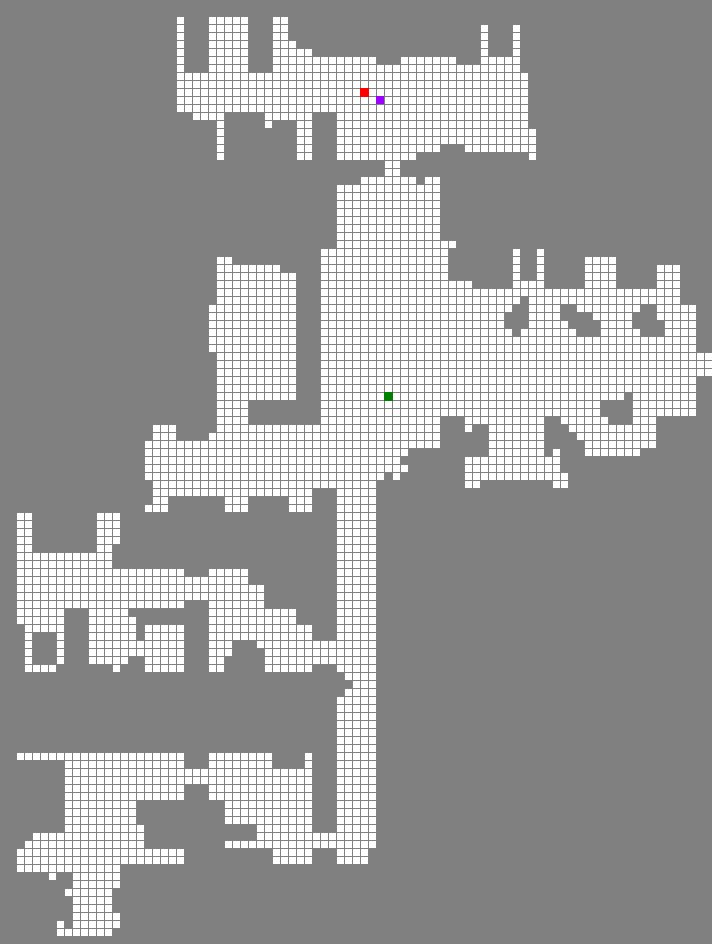

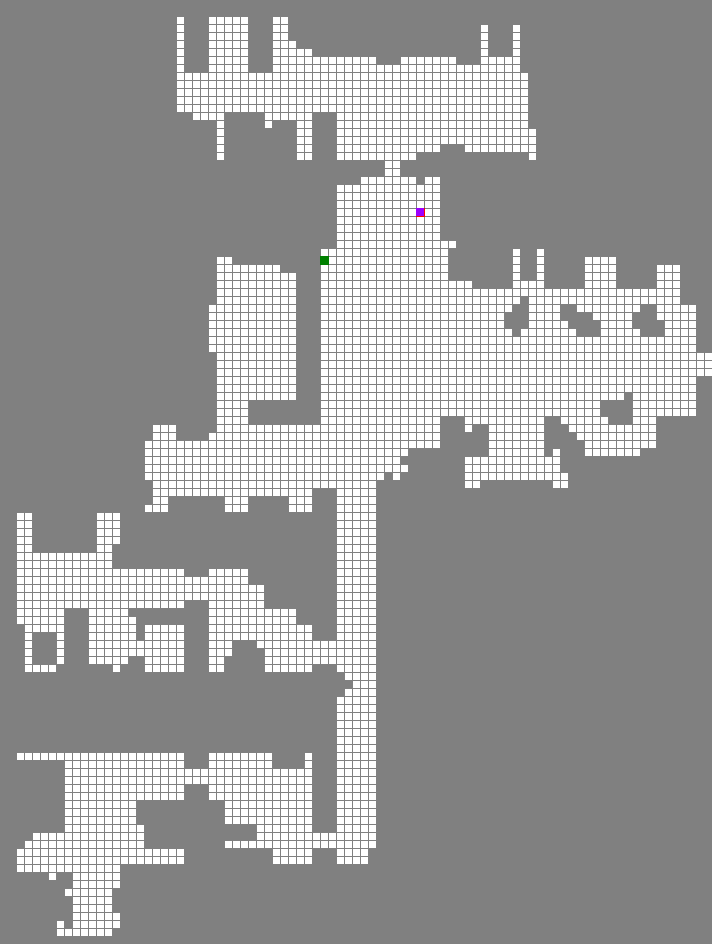

In [161]:
for _ in range(20):
    model.to('cpu')
    model.eval()
    with torch.no_grad():
        start = random.choice(roads)
        goal = random.choice(list(set(roads) - set([start])))
        subgoal = get_subgoal(model, start, goal)
        Vis([
            BitmapLayer(world.bitmap),
            SceneLayer(start, goal),
            SubgoalLayer([subgoal])
        ]).display()

In [176]:
def run_nnhcs(world, start, goal, model):
    lrta = LRTA(weight=16)
    lrta.init_h(world, goal)

    num_steps = 0
    curr = start
    final_path = []
    h_updates = []
    subgoals = []
    images = []
    subgoal = start
    visit_count = np.zeros_like(world.bitmap)
    num_fallbacks = 0

    while curr != goal and num_steps < 300:
    #     print(curr)
        if visit_count[curr.x, curr.y] > 3:
            num_fallbacks += 1
            curr = lrta.get_next_pos(curr, goal, world)
            final_path.append(curr)
            h_updates.append(lrta.h_updates.copy())
            subgoals.append(subgoal)
            visit_count[curr.x, curr.y] += 1
        else:
            subgoal = get_subgoal(model, curr, goal)
    #         subgoal = fix_subgoal(world, subgoal)
    #         poses = hill_climb(world, curr, subgoal, goal)
            poses = hill_climb(world, curr, subgoal, goal, num_steps=5)
            for pos in poses:
                visit_count[pos.x, pos.y] += 1
                final_path.append(pos)
                h_updates.append(lrta.h_updates.copy())
                subgoals.append(subgoal)
            curr = poses[-1]
        num_steps += 1

    for i in range(len(final_path)):
        img = Vis([
            BitmapLayer(world.bitmap),
            SceneLayer(start, goal),
            SubgoalLayer([subgoals[i]]),
            PathLayer(final_path[:i]),
            ColorOverlayLayer(normalize_alpha(h_updates[i].astype(np.float32))),
        ], 4).get_image()
        images.append(img)
        
    opt_path = get_opt_path(world, start, goal).poses
    nnhcs_path = final_path
    print('opt len:', len(opt_path), '\tnnhcs len:', len(nnhcs_path),
          '\tsuboptimality:', round(len(nnhcs_path) / len(opt_path) - 1, 2))

    print('num fallbacks:', num_fallbacks)
    return images

opt len: 138 	nnhcs len: 168 	suboptimality: 0.22
num fallbacks: 1


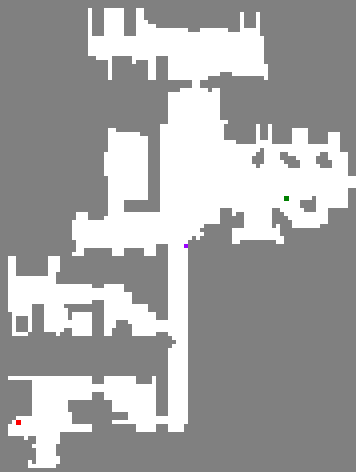

None

opt len: 121 	nnhcs len: 145 	suboptimality: 0.2
num fallbacks: 0


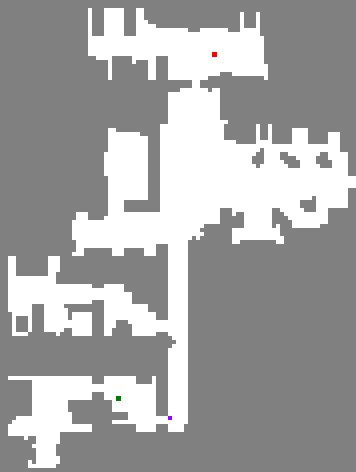

None

opt len: 154 	nnhcs len: 185 	suboptimality: 0.2
num fallbacks: 0


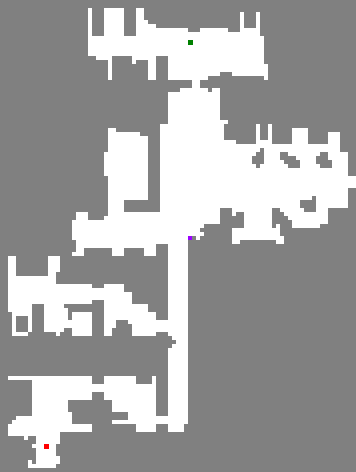

None

opt len: 21 	nnhcs len: 24 	suboptimality: 0.14
num fallbacks: 0


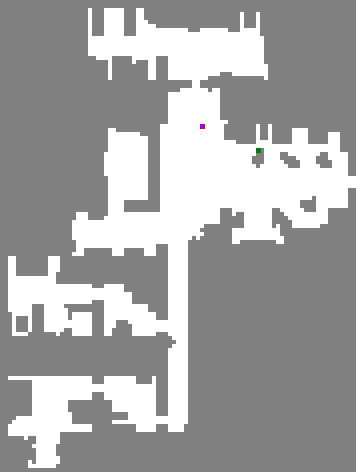

None

opt len: 26 	nnhcs len: 30 	suboptimality: 0.15
num fallbacks: 0


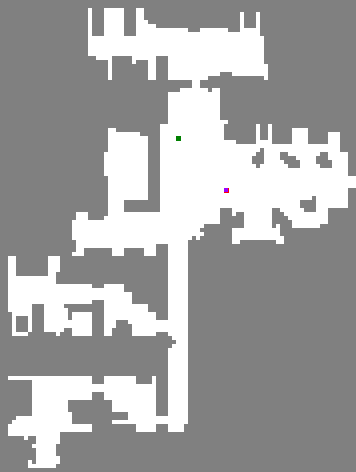

None

opt len: 47 	nnhcs len: 56 	suboptimality: 0.19
num fallbacks: 0


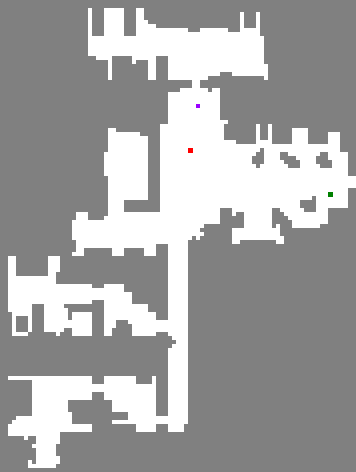

None

opt len: 119 	nnhcs len: 142 	suboptimality: 0.19
num fallbacks: 0


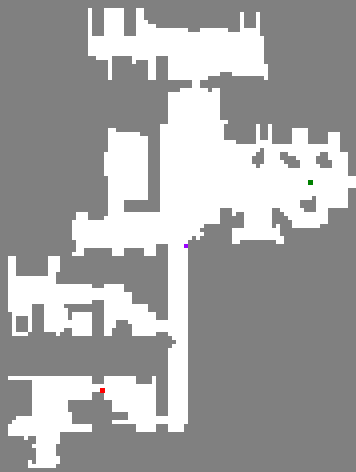

None

opt len: 50 	nnhcs len: 59 	suboptimality: 0.18
num fallbacks: 0


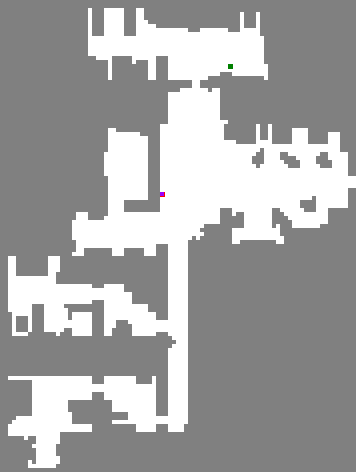

None

opt len: 25 	nnhcs len: 36 	suboptimality: 0.44
num fallbacks: 2


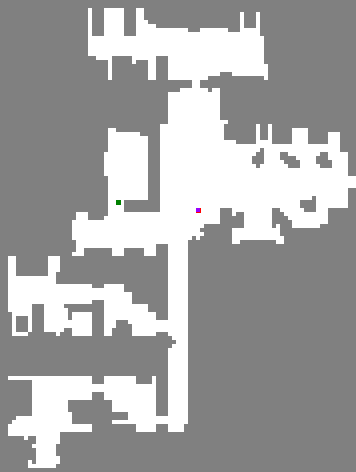

None

opt len: 20 	nnhcs len: 30 	suboptimality: 0.5
num fallbacks: 0


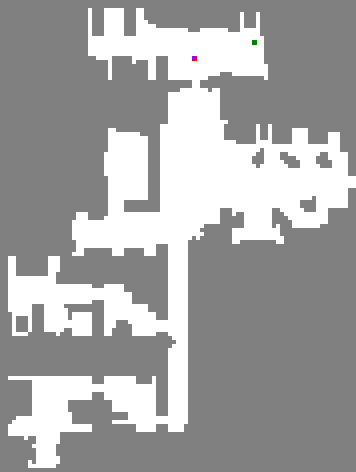

None

In [177]:
seed = 1002923129
for i in range(10):
    random.seed(seed + i)
    start = random.choice(roads)
    goal = random.choice(list(set(roads) - set([start])))
    images = run_nnhcs(world, start, goal, model)
    display.display(get_gif(images))